In [16]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

In [17]:
#pip install --user music21

In [18]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import IPython.display as ipd

import sys
sys.path.append('waveglow/')

from itertools import cycle
import numpy as np
import scipy as sp
from scipy.io.wavfile import write
import pandas as pd
import librosa
import torch

from hparams import create_hparams
from model import Tacotron2, load_model
from waveglow.denoiser import Denoiser
from layers import TacotronSTFT
from data_utils import TextMelLoader, TextMelCollate
from text import cmudict, text_to_sequence
from mellotron_utils import get_data_from_musicxml

In [19]:
def panner(signal, angle):
    angle = np.radians(angle)
    left = np.sqrt(2)/2.0 * (np.cos(angle) - np.sin(angle)) * signal
    right = np.sqrt(2)/2.0 * (np.cos(angle) + np.sin(angle)) * signal
    return np.dstack((left, right))[0]

In [20]:
def plot_mel_f0_alignment(mel_source, mel_outputs_postnet, f0s, alignments, figsize=(16, 16)):
    fig, axes = plt.subplots(4, 1, figsize=figsize)
    axes = axes.flatten()
    axes[0].imshow(mel_source, aspect='auto', origin='bottom', interpolation='none')
    axes[1].imshow(mel_outputs_postnet, aspect='auto', origin='bottom', interpolation='none')
    axes[2].scatter(range(len(f0s)), f0s, alpha=0.5, color='red', marker='.', s=1)
    axes[2].set_xlim(0, len(f0s))
    axes[3].imshow(alignments, aspect='auto', origin='bottom', interpolation='none')
    axes[0].set_title("Source Mel")
    axes[1].set_title("Predicted Mel")
    axes[2].set_title("Source pitch contour")
    axes[3].set_title("Source rhythm")
    plt.tight_layout()

In [21]:
def load_mel(path):
    audio, sampling_rate = librosa.core.load(path, sr=hparams.sampling_rate)
    audio = torch.from_numpy(audio)
    if sampling_rate != hparams.sampling_rate:
        raise ValueError("{} SR doesn't match target {} SR".format(
            sampling_rate, stft.sampling_rate))
    audio_norm = audio.unsqueeze(0)
    audio_norm = torch.autograd.Variable(audio_norm, requires_grad=False)
    melspec = stft.mel_spectrogram(audio_norm)
    melspec = melspec.cuda()
    return melspec

In [22]:
hparams = create_hparams()

In [23]:
stft = TacotronSTFT(hparams.filter_length, hparams.hop_length, hparams.win_length,
                    hparams.n_mel_channels, hparams.sampling_rate, hparams.mel_fmin,
                    hparams.mel_fmax)

In [24]:
hparams

HParams([('attention_dim', 128), ('attention_location_kernel_size', 31), ('attention_location_n_filters', 32), ('attention_rnn_dim', 1024), ('batch_size', 32), ('cmudict_path', 'data/cmu_dictionary'), ('cudnn_benchmark', False), ('cudnn_enabled', True), ('decoder_rnn_dim', 1024), ('dist_backend', 'nccl'), ('dist_url', 'tcp://localhost:54321'), ('distributed_run', False), ('dynamic_loss_scaling', True), ('encoder_embedding_dim', 512), ('encoder_kernel_size', 5), ('encoder_n_convolutions', 3), ('epochs', 50000), ('f0_max', 880), ('f0_min', 80), ('filter_length', 1024), ('fp16_run', False), ('gate_threshold', 0.5), ('grad_clip_thresh', 1.0), ('harm_thresh', 0.25), ('hop_length', 256), ('ignore_layers', ['speaker_embedding.weight']), ('iters_per_checkpoint', 500), ('learning_rate', 0.001), ('learning_rate_anneal', 50000), ('learning_rate_min', 1e-05), ('mask_padding', True), ('max_decoder_steps', 1000), ('max_wav_value', 32768.0), ('mel_fmax', 8000.0), ('mel_fmin', 0.0), ('n_frames_per_ste

## Load Models

In [25]:
checkpoint_path = "models/mellotron_libritts.pt"
mellotron = load_model(hparams).cuda().eval()
mellotron.load_state_dict(torch.load(checkpoint_path)['state_dict'])

<All keys matched successfully>

In [26]:
waveglow_path = 'models/waveglow_256channels_universal_v4.pt'
waveglow = torch.load(waveglow_path)['model'].cuda().eval()
denoiser = Denoiser(waveglow).cuda().eval()

## Load data

In [27]:
%%file data/examples_filelist.txt
# custom_data/final1.wav|So sudden and violent was the fit that the unfortunate prisoner was unable to complete the sentence; a violent convulsion shook his whole frame, his eyes stared from their sockets, his mouth was drawn on one side, his cheeks became purple, he struggled, foamed, dashed himself about, and uttered the most dreadful cries, which, however, Dantes prevented from being heard by covering his head with the blanket.|26
data/example1.wav|exploring the expanses of space to keep our planet safe|1
custom_data/russian6.wav|Please call Stella.  Ask her to bring these things with her from the store:  Six spoons of fresh snow peas, five thick slabs of blue cheese, and maybe a snack for her brother Bob.  We also need a small plastic snake and a big toy frog for the kids.  She can scoop these things into three red bags, and we will go meet her Wednesday at the train station.|0

Overwriting data/examples_filelist.txt


## Setup dataloaders

In [28]:
arpabet_dict = cmudict.CMUDict('data/cmu_dictionary')
audio_paths = 'data/examples_filelist.txt'
dataloader = TextMelLoader(audio_paths, hparams)
datacollate = TextMelCollate(1)

In [29]:
file_idx = 0
audio_path, text, sid = dataloader.audiopaths_and_text[file_idx]

# get audio path, encoded text, pitch contour and mel for gst
text_encoded = torch.LongTensor(text_to_sequence(text, hparams.text_cleaners, arpabet_dict))[None, :].cuda()    
pitch_contour = dataloader[file_idx][3][None].cuda()
mel = load_mel(audio_path)
print(audio_path, text)

# load source data to obtain rhythm using tacotron 2 as a forced aligner
x, y = mellotron.parse_batch(datacollate([dataloader[file_idx]]))

22050
22050


RuntimeError: code is too big

In [15]:
ipd.Audio(audio_path, rate=hparams.sampling_rate)

## Define Speakers Set

In [16]:
speaker_ids = TextMelLoader("filelists/libritts_train_clean_100_audiopath_text_sid_shorterthan10s_atleast5min_train_filelist.txt", hparams).speaker_ids
speakers = pd.read_csv('filelists/libritts_speakerinfo.txt', engine='python',header=None, comment=';', sep=' *\| *', 
                       names=['ID', 'SEX', 'SUBSET', 'MINUTES', 'NAME'])
speakers['MELLOTRON_ID'] = speakers['ID'].apply(lambda x: speaker_ids[x] if x in speaker_ids else -1)
female_speakers = cycle(
    speakers.query("SEX == 'F' and MINUTES > 20 and MELLOTRON_ID >= 0")['MELLOTRON_ID'].sample(frac=1).tolist())
male_speakers = cycle(
    speakers.query("SEX == 'M' and MINUTES > 20 and MELLOTRON_ID >= 0")['MELLOTRON_ID'].sample(frac=1).tolist())

In [17]:
speakers[speakers['MELLOTRON_ID'] >= 0][21:40]

,ID,SEX,SUBSET,MINUTES,NAME,MELLOTRON_ID
414,1088,F,train-clean-100,25.18,Christabel,1
426,1116,F,train-clean-100,25.12,Megan Stemm-Wade,2
457,1246,F,train-clean-100,25.09,Sandra,4
465,1263,F,train-clean-100,25.16,Leonie Rose,6
542,1502,F,train-clean-100,25.05,Ann Boyer,7
561,1578,F,train-clean-100,25.01,Lorelle Anderson,8
662,1841,F,train-clean-100,25.13,Laura Caldwell,9
670,1867,M,train-clean-100,25.16,Rowdy Delaney,10
693,1963,F,train-clean-100,25.19,Belinda Brown,12
695,1970,F,train-clean-100,25.13,Dawn Larsen,13


In [18]:
with torch.no_grad():
    # get rhythm (alignment map) using tacotron 2
    mel_outputs, mel_outputs_postnet, gate_outputs, rhythm = mellotron.forward(x)
    rhythm = rhythm.permute(1, 0, 2)

Current_Speaker_Id is: 4


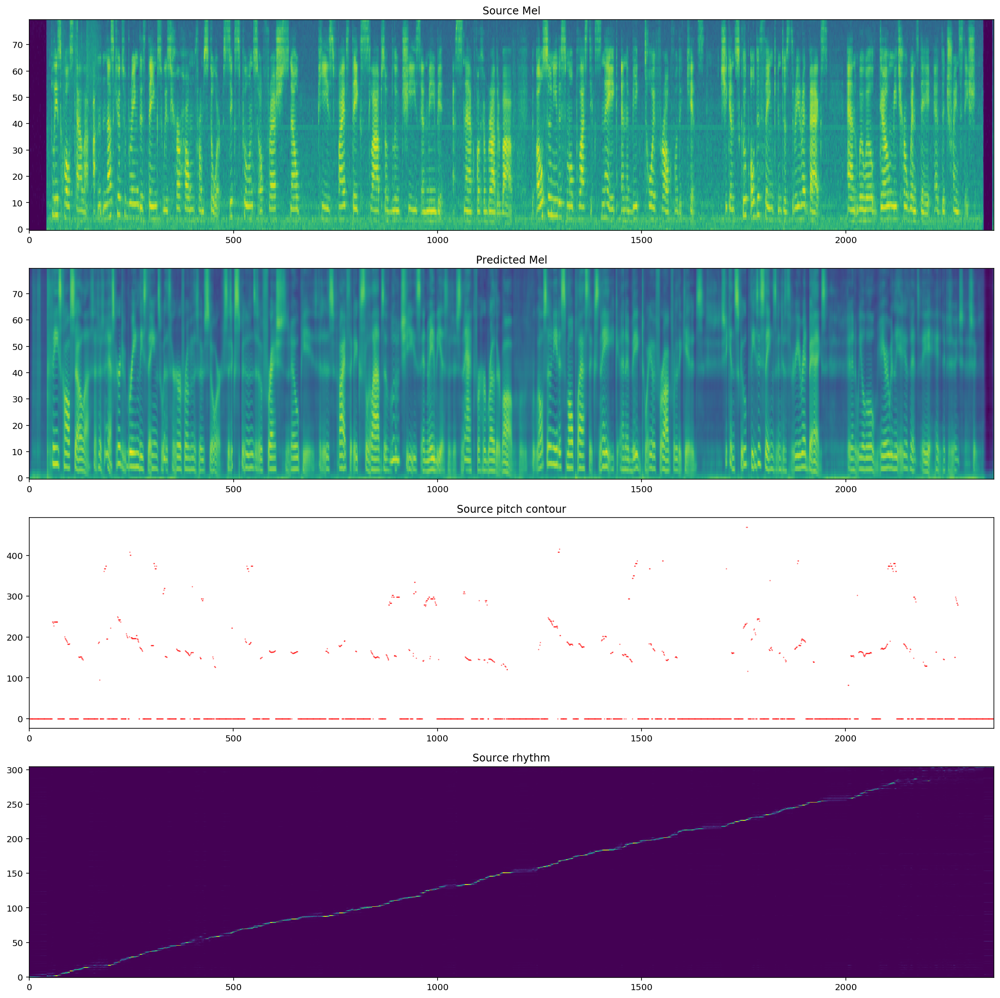

In [19]:
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = 4
print(f'Current_Speaker_Id is: {speaker_id}')
ind = speaker_id
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = mellotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
                      mel_outputs_postnet.data.cpu().numpy()[0],
                      pitch_contour.data.cpu().numpy()[0, 0],
                      rhythm.data.cpu().numpy()[:, 0].T)

In [20]:
speakers[speakers['MELLOTRON_ID'] == ind]

,ID,SEX,SUBSET,MINUTES,NAME,MELLOTRON_ID
457,1246,F,train-clean-100,25.09,Sandra,4


In [21]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.5), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

In [29]:
data = get_data_from_musicxml('data/haendel_hallelujah.musicxml', 132, convert_stress=True)
panning = {'Soprano': [-60, -30], 'Alto': [-40, -10], 'Tenor': [30, 60], 'Bass': [10, 40]}

n_speakers_per_part = 4
frequency_scaling = 0.4
n_seconds = 90
audio_stereo = np.zeros((hparams.sampling_rate*n_seconds, 2), dtype=np.float32)
for i, (part, v) in enumerate(data.items()):
    rhythm = data[part]['rhythm'].cuda()
    pitch_contour = data[part]['pitch_contour'].cuda()
    text_encoded = data[part]['text_encoded'].cuda()
    
    for k in range(n_speakers_per_part):
        pan = np.random.randint(panning[part][0], panning[part][1])
        if any(x in part.lower() for x in ('soprano', 'alto', 'female')):
            speaker_id = torch.LongTensor([next(female_speakers)]).cuda()
        else:
            speaker_id = torch.LongTensor([next(male_speakers)]).cuda()
        print("{} MellotronID {} pan {}".format(part, speaker_id.item(), pan))

        with torch.no_grad():
            mel_outputs, mel_outputs_postnet, gate_outputs, alignments_transfer = mellotron.inference_noattention(
                (text_encoded, mel, speaker_id, pitch_contour*frequency_scaling, rhythm))

            audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.8), 0.01)[0, 0]
            audio = audio.cpu().numpy()
            audio = panner(audio, pan)
            audio_stereo[:audio.shape[0]] += audio            
            write("{} {}.wav".format(part, speaker_id.item()), hparams.sampling_rate, audio)
            
audio_stereo = audio_stereo / np.max(np.abs(audio_stereo))
write("audio_stereo.wav", hparams.sampling_rate, audio_stereo)
ipd.Audio([audio_stereo[:,0], audio_stereo[:,1]], rate=hparams.sampling_rate)

Soprano MellotronID 95 pan -45
Soprano MellotronID 30 pan -39
Soprano MellotronID 43 pan -32
Soprano MellotronID 4 pan -48
Alto MellotronID 62 pan -34
Alto MellotronID 0 pan -19
Alto MellotronID 9 pan -15
Alto MellotronID 33 pan -29
Tenor MellotronID 73 pan 31
Tenor MellotronID 106 pan 32
Tenor MellotronID 80 pan 36
Tenor MellotronID 3 pan 37
Bass MellotronID 120 pan 38
Bass MellotronID 66 pan 17
Bass MellotronID 34 pan 39
Bass MellotronID 56 pan 25


In [54]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.5), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

In [ ]:
import soundfile

path = 'custom_results/denoise_hallelujah.wav'
soundfile.write(path, audio[0].data.cpu().numpy(), samplerate = hparams.sampling_rate, subtype='PCM_16')

In [155]:
#soundfile.SoundFile('data/eastwood_lawyers.wav')


data, samplerate = soundfile.read('custom_data/eastwood_lawyers_1.wav')
soundfile.write('custom_data/eastwood_lawyers_2.wav', data.sum(axis=1), samplerate = 22050, subtype='PCM_16')

In [145]:
%%file data/examples_filelist.txt
# custom_data/final1.wav|So sudden and violent was the fit that the unfortunate prisoner was unable to complete the sentence; a violent convulsion shook his whole frame, his eyes stared from their sockets, his mouth was drawn on one side, his cheeks became purple, he struggled, foamed, dashed himself about, and uttered the most dreadful cries, which, however, Dantes prevented from being heard by covering his head with the blanket.|26
data/example1.wav|exploring the expanses of space to keep our planet safe|1
data/eastwood_lawyers_2.wav|Who in America gives these, uh, lawyers the... to be the self-appointed vigilantes to, uh, to enforce the law?|5

Overwriting data/examples_filelist.txt


In [99]:
"data/eastwood_lawyers.wav|Who in America gives these, uh, lawyers the... to be the self-appointed vigilantes to, uh, to enforce the law?|5"

('CE',
 'Who in America gives these, uh, lawyers the... to be the self-appointed vigilantes to, uh, to enforce the law?')

In [94]:
"data/hawking02.wav|My illness has made very little difference to my scientific work. It was lucky to have chosen theoretical physics, that is mainly pure thought, for which my physical disability is no handicap. I may be mentally disabled as well, but if so, I'm too far gone to realize.|6"

"My illness has made very little difference to my scientific work. It was lucky to have chosen theoretical physics, that is mainly pure thought, for which my physical disability is no handicap. I may be mentally disabled as well, but if so, I'm too far gone to realize."

In [97]:
"data/king_war_no_more.wav|I don't know about you. I ain't gonna study war... no more.|7"

('MLK', "I don't know about you. I ain't gonna study war... no more.")

In [100]:
"data/jackson_allegations.wav|I am totally innocent of any wrongdoing, and I know these terrible allegations will all be proven false.|8"

'data/jackson_allegations.wav|I am totally innocent of any wrongdoing, and I know these terrible allegations will all be proven false.|8'

In [156]:
hparams.sampling_rate = 22050
dataloader = TextMelLoader(audio_paths, hparams)
datacollate = TextMelCollate(1)

In [157]:
file_idx = 0
audio_path, text, sid = dataloader.audiopaths_and_text[file_idx]
print(audio_path, text, sid)
# get audio path, encoded text, pitch contour and mel for gst
text_encoded = torch.LongTensor(text_to_sequence(text, hparams.text_cleaners, arpabet_dict))[None, :].cuda()    
#print(text_encoded)
pitch_contour = dataloader[file_idx][3][None].cuda()
mel = load_mel(audio_path)
#print(audio_path, text)

# load source data to obtain rhythm using tacotron 2 as a forced aligner
x, y = mellotron.parse_batch(datacollate([dataloader[file_idx]]))

data/eastwood_lawyers_2.wav Who in America gives these, uh, lawyers the... to be the self-appointed vigilantes to, uh, to enforce the law? 5


In [158]:
with torch.no_grad():
    # get rhythm (alignment map) using tacotron 2
    mel_outputs, mel_outputs_postnet, gate_outputs, rhythm = mellotron.forward(x)
    rhythm = rhythm.permute(1, 0, 2)

Current_Speaker_Id is: 11


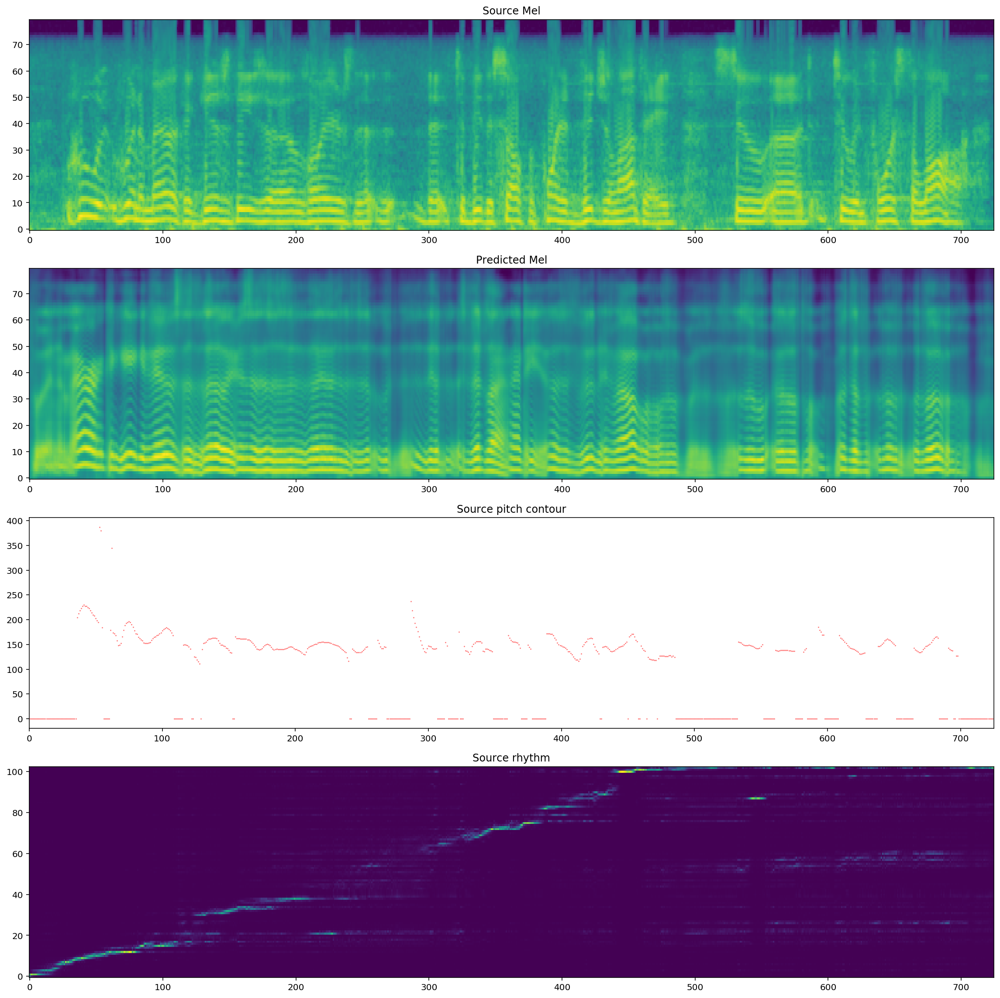

In [159]:
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = 11
print(f'Current_Speaker_Id is: {speaker_id}')
ind = speaker_id
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = mellotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
                      mel_outputs_postnet.data.cpu().numpy()[0],
                      pitch_contour.data.cpu().numpy()[0, 0],
                      rhythm.data.cpu().numpy()[:, 0].T)

In [160]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.5), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

In [ ]:
path = 'custom_results/clint_eastwood.wav'
soundfile.write(path, audio[0].data.cpu().numpy(), samplerate = hparams.sampling_rate, subtype='PCM_16')

In [163]:
#soundfile.SoundFile('data/hawking02.wav')


data, samplerate = soundfile.read('custom_data/hawking02_1.wav')
soundfile.write('custom_data/hawking02_2.wav', data.sum(axis=1), samplerate = 22050, subtype='PCM_16')

In [165]:
%%file data/examples_filelist.txt
# custom_data/final1.wav|So sudden and violent was the fit that the unfortunate prisoner was unable to complete the sentence; a violent convulsion shook his whole frame, his eyes stared from their sockets, his mouth was drawn on one side, his cheeks became purple, he struggled, foamed, dashed himself about, and uttered the most dreadful cries, which, however, Dantes prevented from being heard by covering his head with the blanket.|26
data/example1.wav|exploring the expanses of space to keep our planet safe|1
data/hawking02_2.wav|My illness has made very little difference to my scientific work. It was lucky to have chosen theoretical physics, that is mainly pure thought, for which my physical disability is no handicap. I may be mentally disabled as well, but if so, I am too far gone to realize.|6

Overwriting data/examples_filelist.txt


data/hawking02_2.wav My illness has made very little difference to my scientific work. It was lucky to have chosen theoretical physics, that is mainly pure thought, for which my physical disability is no handicap. I may be mentally disabled as well, but if so, I am too far gone to realize. 6
Current_Speaker_Id is: 4


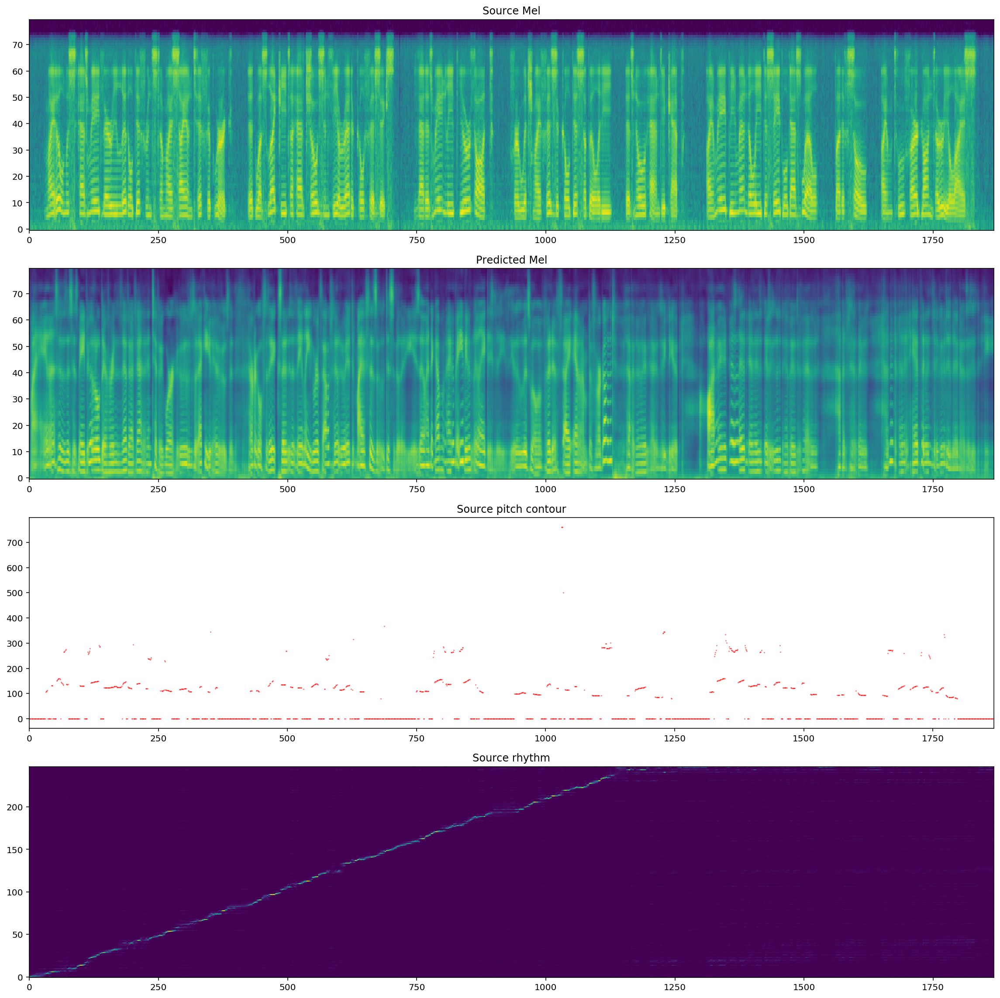

In [166]:
#hparams.sampling_rate = 11025
dataloader = TextMelLoader(audio_paths, hparams)
datacollate = TextMelCollate(1)


file_idx = 0
audio_path, text, sid = dataloader.audiopaths_and_text[file_idx]
print(audio_path, text, sid)
# get audio path, encoded text, pitch contour and mel for gst
text_encoded = torch.LongTensor(text_to_sequence(text, hparams.text_cleaners, arpabet_dict))[None, :].cuda()    
#print(text_encoded)
pitch_contour = dataloader[file_idx][3][None].cuda()
mel = load_mel(audio_path)
#print(audio_path, text)

# load source data to obtain rhythm using tacotron 2 as a forced aligner
x, y = mellotron.parse_batch(datacollate([dataloader[file_idx]]))


with torch.no_grad():
    # get rhythm (alignment map) using tacotron 2
    mel_outputs, mel_outputs_postnet, gate_outputs, rhythm = mellotron.forward(x)
    rhythm = rhythm.permute(1, 0, 2)
    
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = 4
print(f'Current_Speaker_Id is: {speaker_id}')
ind = speaker_id
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = mellotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
                      mel_outputs_postnet.data.cpu().numpy()[0],
                      pitch_contour.data.cpu().numpy()[0, 0],
                      rhythm.data.cpu().numpy()[:, 0].T)    

In [167]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.5), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

In [ ]:
path = 'custom_results/Hawking.wav'
soundfile.write(path, audio[0].data.cpu().numpy(), samplerate = hparams.sampling_rate, subtype='PCM_16')

In [168]:
data, samplerate = soundfile.read('custom_data/king_war_no_more_1.wav')
soundfile.write('custom_data/king_war_no_more_2.wav', data.sum(axis=1), samplerate = 22050, subtype='PCM_16')

In [171]:
%%file data/examples_filelist.txt
# custom_data/final1.wav|So sudden and violent was the fit that the unfortunate prisoner was unable to complete the sentence; a violent convulsion shook his whole frame, his eyes stared from their sockets, his mouth was drawn on one side, his cheeks became purple, he struggled, foamed, dashed himself about, and uttered the most dreadful cries, which, however, Dantes prevented from being heard by covering his head with the blanket.|26
data/example1.wav|exploring the expanses of space to keep our planet safe|1
data/king_war_no_more_2.wav|I don't know about you. I ain't gonna study war... no more.|7

Overwriting data/examples_filelist.txt


data/king_war_no_more_2.wav I don't know about you. I ain't gonna study war... no more. 7


/home/lmd003/dsc160-final-dsc160-final-group14/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method
/home/lmd003/dsc160-final-dsc160-final-group14/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method


Current_Speaker_Id is: 4


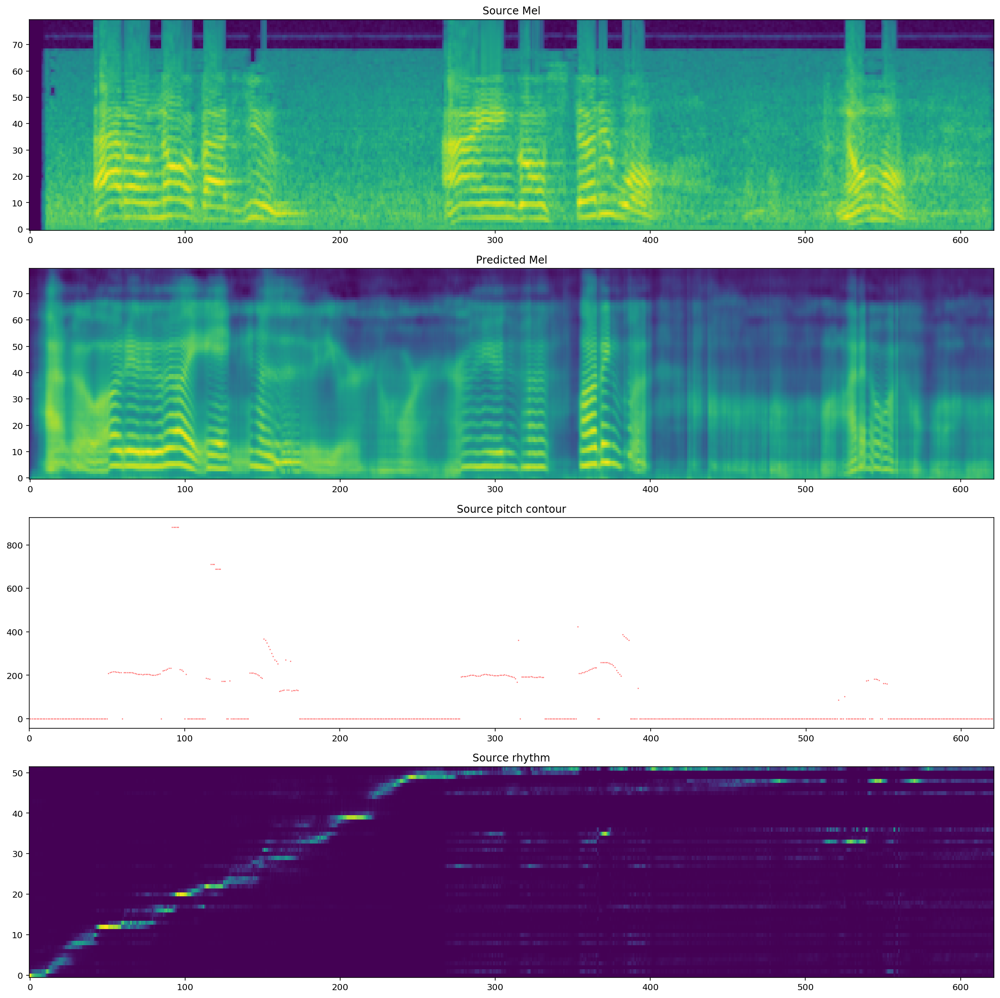

In [172]:
#hparams.sampling_rate = 11025
dataloader = TextMelLoader(audio_paths, hparams)
datacollate = TextMelCollate(1)


file_idx = 0
audio_path, text, sid = dataloader.audiopaths_and_text[file_idx]
print(audio_path, text, sid)
# get audio path, encoded text, pitch contour and mel for gst
text_encoded = torch.LongTensor(text_to_sequence(text, hparams.text_cleaners, arpabet_dict))[None, :].cuda()    
#print(text_encoded)
pitch_contour = dataloader[file_idx][3][None].cuda()
mel = load_mel(audio_path)
#print(audio_path, text)

# load source data to obtain rhythm using tacotron 2 as a forced aligner
x, y = mellotron.parse_batch(datacollate([dataloader[file_idx]]))


with torch.no_grad():
    # get rhythm (alignment map) using tacotron 2
    mel_outputs, mel_outputs_postnet, gate_outputs, rhythm = mellotron.forward(x)
    rhythm = rhythm.permute(1, 0, 2)
    
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = 4
print(f'Current_Speaker_Id is: {speaker_id}')
ind = speaker_id
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = mellotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
                      mel_outputs_postnet.data.cpu().numpy()[0],
                      pitch_contour.data.cpu().numpy()[0, 0],
                      rhythm.data.cpu().numpy()[:, 0].T)    

In [173]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.5), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

In [ ]:
path = 'custom_results/MLK.wav'
soundfile.write(path, audio[0].data.cpu().numpy(), samplerate = hparams.sampling_rate, subtype='PCM_16')

In [182]:
data, samplerate = soundfile.read('custom_data/camel6_1.wav')
soundfile.write('custom_data/camel6_2.wav', data.sum(axis=1), samplerate = 22050, subtype='PCM_16')

In [185]:
%%file data/examples_filelist.txt
# custom_data/final1.wav|So sudden and violent was the fit that the unfortunate prisoner was unable to complete the sentence; a violent convulsion shook his whole frame, his eyes stared from their sockets, his mouth was drawn on one side, his cheeks became purple, he struggled, foamed, dashed himself about, and uttered the most dreadful cries, which, however, Dantes prevented from being heard by covering his head with the blanket.|26
data/example1.wav|exploring the expanses of space to keep our planet safe|1
custom_data/camel6_2.wav|Ahh|0

Overwriting data/examples_filelist.txt


custom_data/camel6_2.wav Awww 0
Current_Speaker_Id is: 4


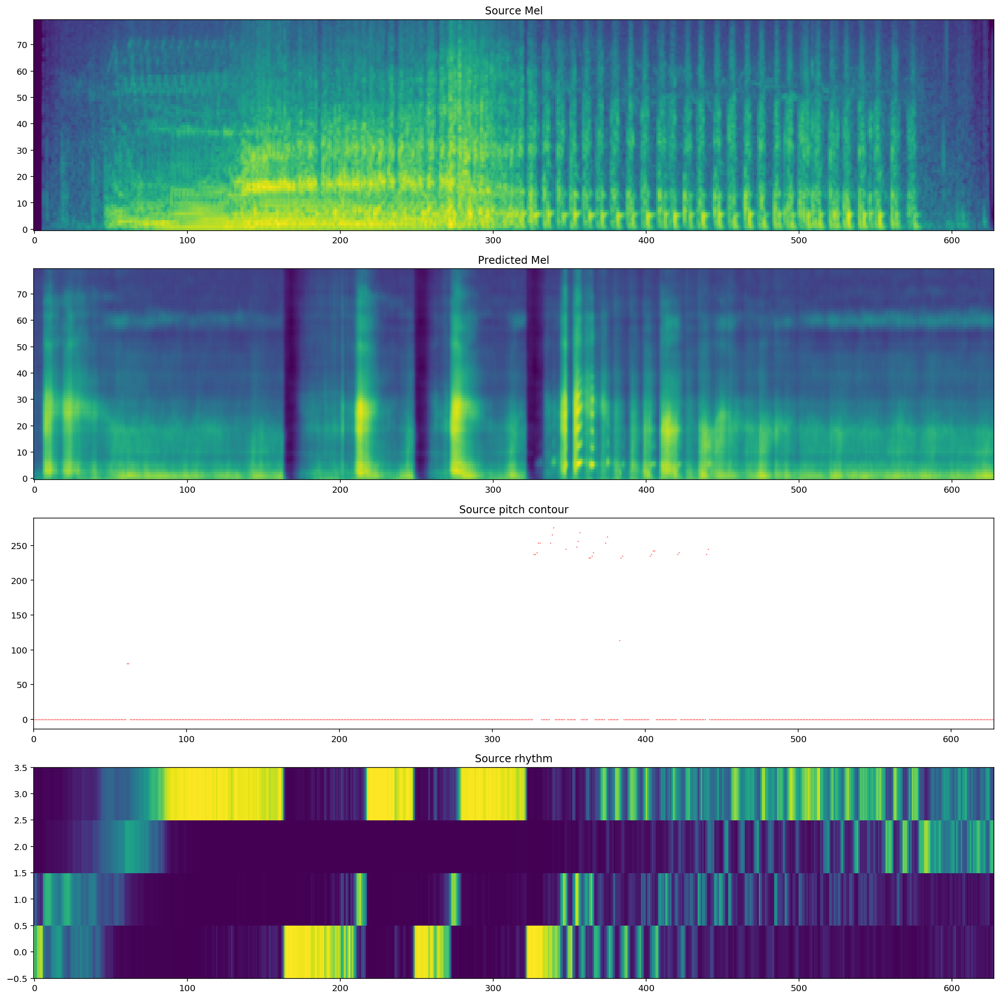

In [186]:
dataloader = TextMelLoader(audio_paths, hparams)
datacollate = TextMelCollate(1)


file_idx = 0
audio_path, text, sid = dataloader.audiopaths_and_text[file_idx]
print(audio_path, text, sid)
# get audio path, encoded text, pitch contour and mel for gst
text_encoded = torch.LongTensor(text_to_sequence(text, hparams.text_cleaners, arpabet_dict))[None, :].cuda()    
#print(text_encoded)
pitch_contour = dataloader[file_idx][3][None].cuda()
mel = load_mel(audio_path)
#print(audio_path, text)

# load source data to obtain rhythm using tacotron 2 as a forced aligner
x, y = mellotron.parse_batch(datacollate([dataloader[file_idx]]))


with torch.no_grad():
    # get rhythm (alignment map) using tacotron 2
    mel_outputs, mel_outputs_postnet, gate_outputs, rhythm = mellotron.forward(x)
    rhythm = rhythm.permute(1, 0, 2)
    
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = 4
print(f'Current_Speaker_Id is: {speaker_id}')
ind = speaker_id
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = mellotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
                      mel_outputs_postnet.data.cpu().numpy()[0],
                      pitch_contour.data.cpu().numpy()[0, 0],
                      rhythm.data.cpu().numpy()[:, 0].T)  

In [187]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.5), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

In [ ]:
path = 'custom_results/camel.wav'
soundfile.write(path, audio[0].data.cpu().numpy(), samplerate = hparams.sampling_rate, subtype='PCM_16')

In [195]:
data, samplerate = soundfile.read('custom_data/invader_zim_1.wav')
soundfile.write('custom_data/invader_zim_2.wav', data.sum(axis=1), samplerate = 22050, subtype='PCM_16')

In [196]:
%%file data/examples_filelist.txt
# custom_data/final1.wav|So sudden and violent was the fit that the unfortunate prisoner was unable to complete the sentence; a violent convulsion shook his whole frame, his eyes stared from their sockets, his mouth was drawn on one side, his cheeks became purple, he struggled, foamed, dashed himself about, and uttered the most dreadful cries, which, however, Dantes prevented from being heard by covering his head with the blanket.|26
data/example1.wav|exploring the expanses of space to keep our planet safe|1
custom_data/invader_zim_2.wav|I have a good feeling about this lead. I can almost taste the jumans being destroyed. It's DELICIOUS!|0

Overwriting data/examples_filelist.txt


custom_data/invader_zim_2.wav I have a good feeling about this lead. I can almost taste the jumans being destroyed. It's DELICIOUS! 0
Current_Speaker_Id is: 4


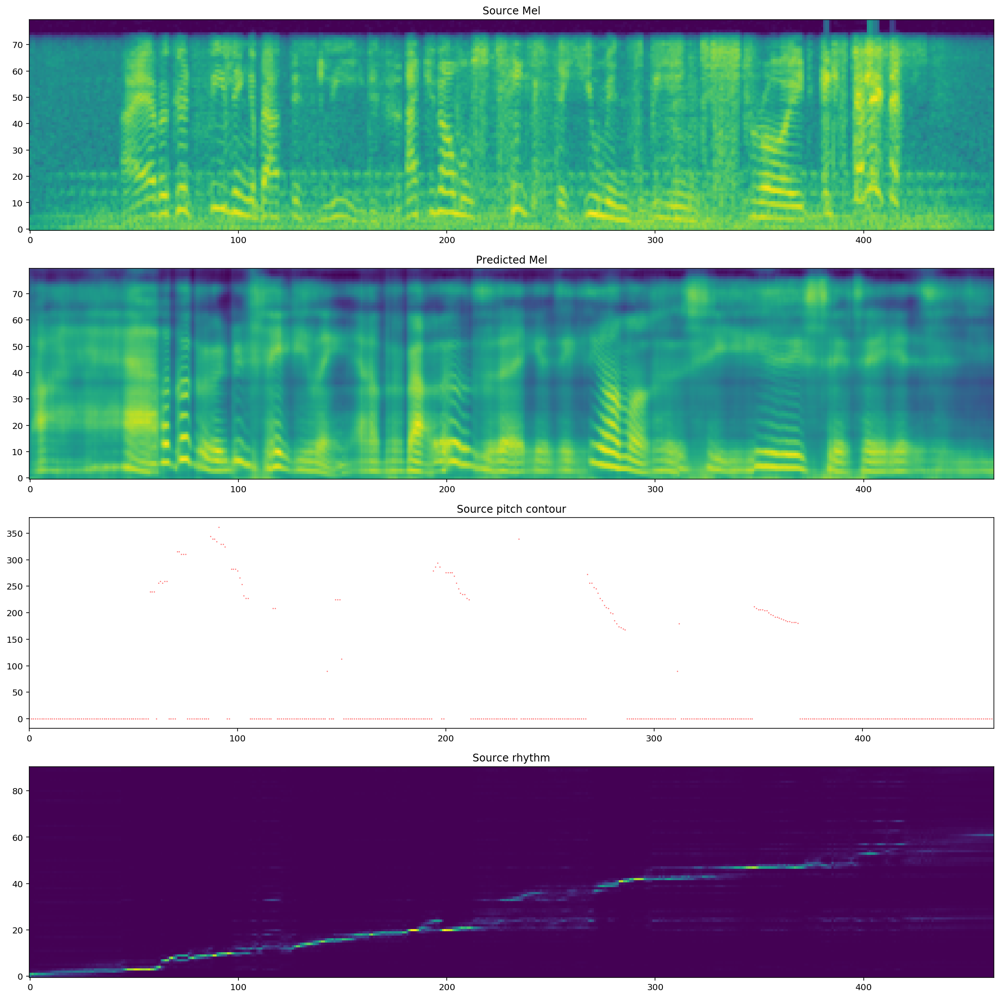

In [197]:
dataloader = TextMelLoader(audio_paths, hparams)
datacollate = TextMelCollate(1)


file_idx = 0
audio_path, text, sid = dataloader.audiopaths_and_text[file_idx]
print(audio_path, text, sid)
# get audio path, encoded text, pitch contour and mel for gst
text_encoded = torch.LongTensor(text_to_sequence(text, hparams.text_cleaners, arpabet_dict))[None, :].cuda()    
#print(text_encoded)
pitch_contour = dataloader[file_idx][3][None].cuda()
mel = load_mel(audio_path)
#print(audio_path, text)

# load source data to obtain rhythm using tacotron 2 as a forced aligner
x, y = mellotron.parse_batch(datacollate([dataloader[file_idx]]))


with torch.no_grad():
    # get rhythm (alignment map) using tacotron 2
    mel_outputs, mel_outputs_postnet, gate_outputs, rhythm = mellotron.forward(x)
    rhythm = rhythm.permute(1, 0, 2)
    
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = 4
print(f'Current_Speaker_Id is: {speaker_id}')
ind = speaker_id
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = mellotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
                      mel_outputs_postnet.data.cpu().numpy()[0],
                      pitch_contour.data.cpu().numpy()[0, 0],
                      rhythm.data.cpu().numpy()[:, 0].T)  

In [198]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.5), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

In [ ]:
path = 'custom_results/invader_zim.wav'
soundfile.write(path, audio[0].data.cpu().numpy(), samplerate = hparams.sampling_rate, subtype='PCM_16')